<a href="https://colab.research.google.com/github/RodrigoRVSN/deidara/blob/main/07_filtros_solved.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# <center>Centro Universitário Facens<br/></center>
<br/>
<font size="4"><center><b>Disciplina: Processamento de imagens</b></center></font>
  
<font size="3"><center>Prof. Renato Moraes Silva</center></font>
<br/>
<br/>

# Filtros

Neste notebook, iremos testar alguns filtros. 

Primeiro, iremos importar as principais bibliotecas.

In [ ]:
import numpy as np
import cv2  
import os
import urllib.request
import matplotlib.pyplot as plt

Iremos fazer o download de duas imagens. A primeira imagem é normal, enquanto que a segunda contém ruído sal-pimenta.

In [ ]:
pathFolder = 'figs/'

# verifica que a pasta existe
if not os.path.exists(pathFolder):
    # cria a pasta
    os.makedirs(pathFolder)

url = 'https://raw.githubusercontent.com/MeteHanC/Python-Median-Filter/master/Screenshots/noisyimg.png'
urllib.request.urlretrieve(url, pathFolder + "img1.png")  

url = 'https://i.dailymail.co.uk/i/pix/2012/06/22/article-2163232-13BB4A21000005DC-80_634x472.jpg'
urllib.request.urlretrieve(url, pathFolder + "img2.jpg")  

('figs/img2.jpg', <http.client.HTTPMessage at 0x7fe7366b87c0>)

Execute o código abaixo para carregar as imagens que serão tratadas. 

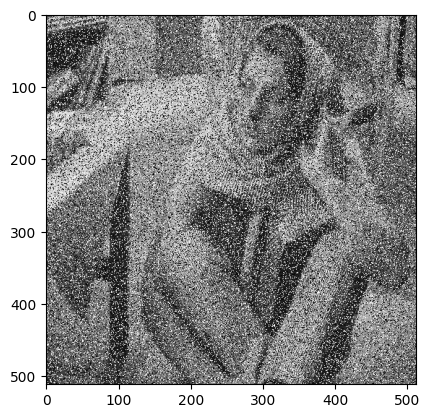

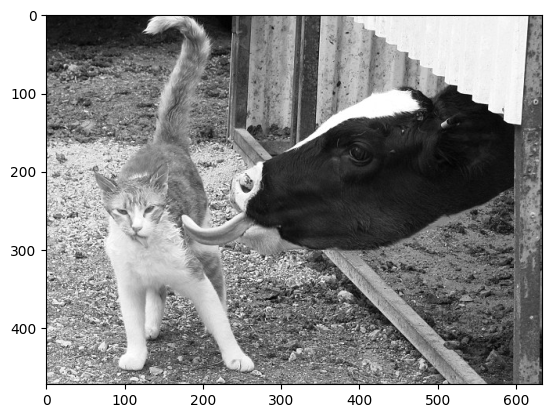

In [ ]:
import cv2 
import matplotlib.pyplot as plt

# abre a imagem em tons de cinza
img1 = cv2.imread('figs/img1.png', 0)

# abre a imagem em tons de cinza
img2 = cv2.imread('figs/img2.jpg', 0)

plt.imshow(img1,'gray', vmax=255, vmin=0)
plt.show()

plt.imshow(img2,'gray', vmax=255, vmin=0)
plt.show()

Aplique o filtro de média nas duas imagens usando a função blur da biblioteca OpenCV. 

Altere a variável *dimMascara* usada para definir a dimensão da máscara e veja o efeito no resultado do filtro.

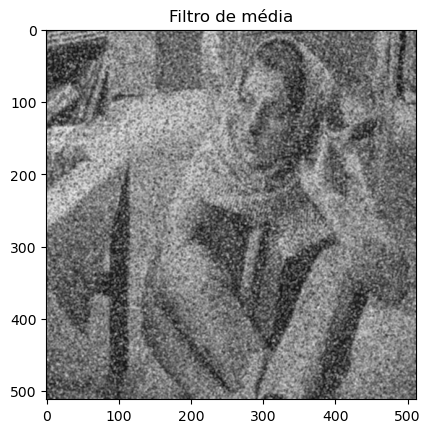

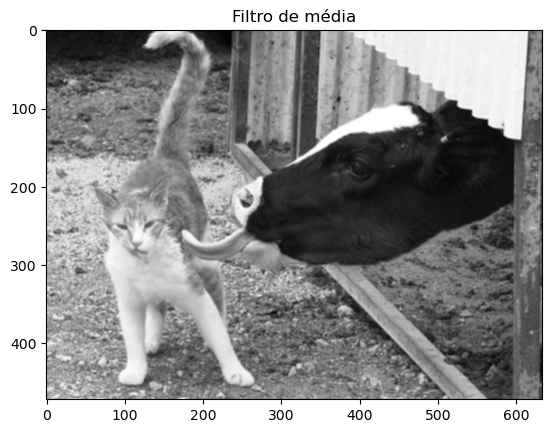

In [ ]:
################# COMPLETE O CÓDIGO AQUI  #################
# Use a função blur da OpenCV para aplicar o filtro de média
# -- A primeira entrada dessa função é a imagem. 
# -- A segunda entrada é a dimensão, no formato (dim1,dim2)

# define o tamanho do kernel
dimMascara = 3

# filtro de média
filtroMedia1 = cv2.blur( img1, (dimMascara,dimMascara) )
filtroMedia2 = cv2.blur( img2, (dimMascara,dimMascara) )

##########################################################

plt.imshow(filtroMedia1,'gray', vmax=255, vmin=0)
plt.title('Filtro de média')
plt.show()

plt.imshow(filtroMedia2,'gray', vmax=255, vmin=0)
plt.title('Filtro de média')
plt.show()

Aplique o filtro da mediana. Altere a dimensão da máscara para ver o efeito.

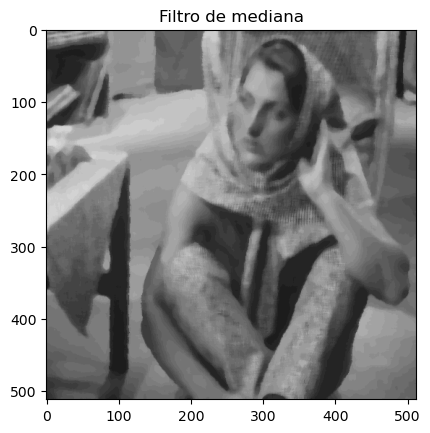

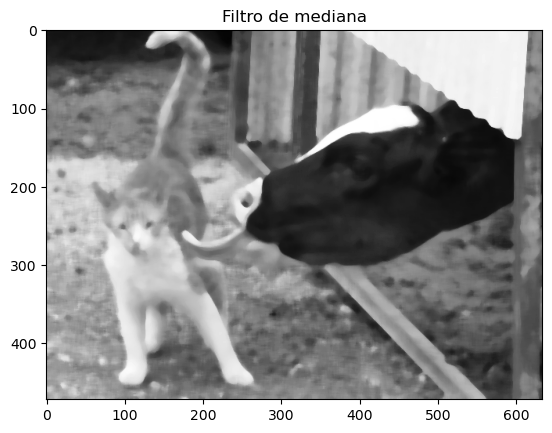

In [ ]:
################# COMPLETE O CÓDIGO AQUI  #################
# Use a função medianBlur da OpenCV para aplicar o filtro de mediana
# -- A primeira entrada dessa função é a imagem. 
# -- A segunda entrada é a dimensão, no formato (dim1,dim2)

# define o tamanho do kernel
dimMascara = 9

# filtro de mediana
filtroMediana1 = cv2.medianBlur(img1, dimMascara)
filtroMediana2 = cv2.medianBlur(img2, dimMascara)

##########################################################

plt.imshow(filtroMediana1,'gray', vmax=255, vmin=0)
plt.title('Filtro de mediana')
plt.show()

plt.imshow(filtroMediana2,'gray', vmax=255, vmin=0)
plt.title('Filtro de mediana')
plt.show()

Aplique o filtro Gaussiano. Altere a dimensão da máscara para ver o efeito.

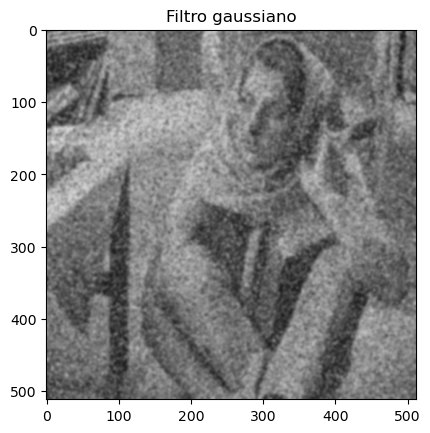

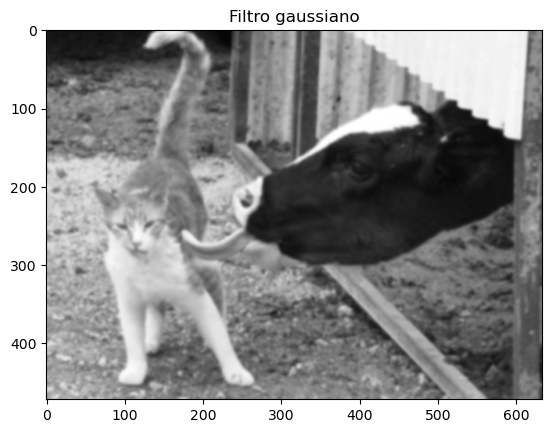

In [ ]:
################# COMPLETE O CÓDIGO AQUI  #################
# Use a função GaussianBlur da OpenCV para aplicar o filtro gaussiano
# -- A primeira entrada dessa função é a imagem. 
# -- A segunda entrada é a dimensão, no formato (dim1,dim2).
# -- A terceira entrada é o sigmaX: desvio padrão (sigma) na direção x. Se for zero, o desvio padrão é calculado a partir do tamanho do kernel. Quanto maior o valor de sigma, mais intensa é a suavização
# -- A quarta entrada é o sigmaY: desvio padrão (sigma) na direção y. Se for zero, o desvio padrão é igual ao sigmaX.

# define o tamanho do kernel
dimMascara = 9

# aplica o filtro Gaussinao
filtroGauss1 = cv2.GaussianBlur(img1, (dimMascara,dimMascara), 0)
filtroGauss2 = cv2.GaussianBlur(img2, (dimMascara,dimMascara), 0)

plt.imshow(filtroGauss1,'gray', vmax=255, vmin=0)
plt.title('Filtro gaussiano')
plt.show()

plt.imshow(filtroGauss2, 'gray', vmax=255, vmin=0)
plt.title('Filtro gaussiano')
plt.show()

Aplique um filtro de realce, usando as seguintes máscaras:

$$
\begin{bmatrix}
0 & -1 & 0\\
-1 & 5 & -1\\
0 & -1 & 0 
\end{bmatrix}
$$

$$
\begin{bmatrix}
-1 & -1 & -1\\
-1 & 10 & -1\\
-1 & -1 & -1 
\end{bmatrix}
$$

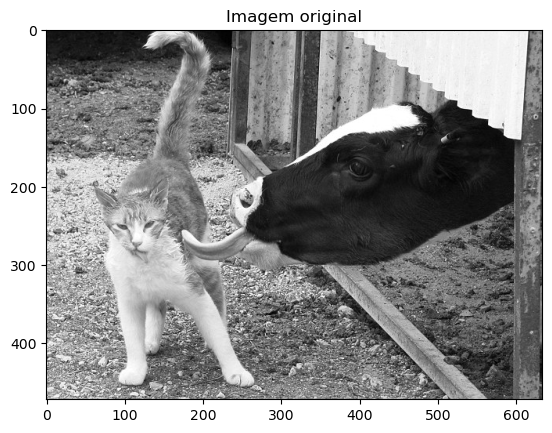

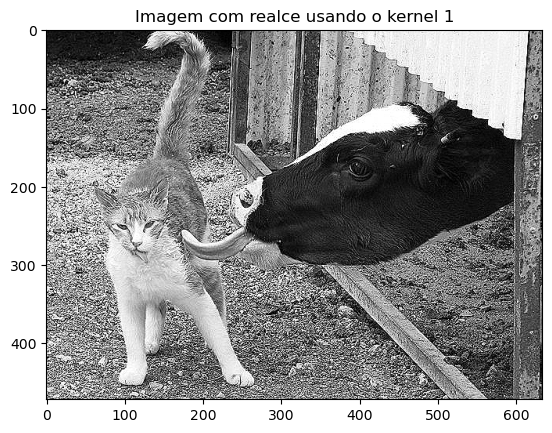

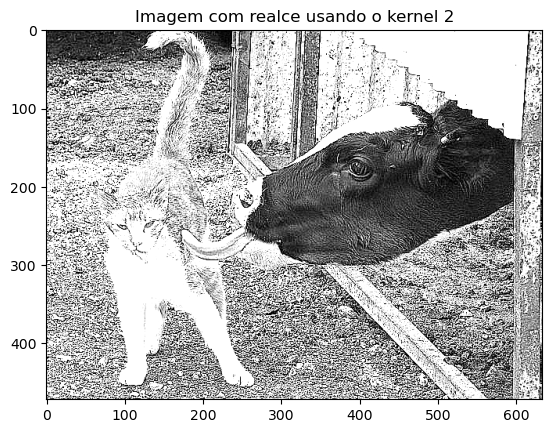

In [ ]:
################# COMPLETE O CÓDIGO AQUI  #################
# Use a função filter2D da OpenCV para aplicar a correlação
# -- A primeira entrada dessa função é a imagem. 
# -- A segunda entrada é a dimensão, no formato (dim1,dim2).
# -- A terceira entrada é o sigmaX: desvio padrão (sigma) na direção x. Se for zero, o desvio padrão é calculado a partir do tamanho do kernel. Quanto maior o valor de sigma, mais intensa é a suavização
# -- A quarta entrada é o sigmaY: desvio padrão (sigma) na direção y. Se for zero, o desvio padrão é igual ao sigmaX.


kernel1 = np.array([[0, -1, 0],
                   [-1, 5, -1],
                   [0, -1, 0]])

kernel2 = np.array([[-1, -1, -1],
                   [-1, 10, -1],
                   [-1, -1, -1]])

# use ddepth para que o resultado continue tendo 8 bits por pixelss
imgRealce1 = cv2.filter2D(src=img2, ddepth=-1, kernel=kernel1)
imgRealce2 = cv2.filter2D(src=img2, ddepth=-1, kernel=kernel2)

##########################################################

plt.imshow(img2,'gray', vmax=255, vmin=0)
plt.title("Imagem original")
plt.show()

plt.imshow(imgRealce1,'gray', vmax=255, vmin=0)
plt.title("Imagem com realce usando o kernel 1")
plt.show()

plt.imshow(imgRealce2,'gray', vmax=255, vmin=0)
plt.title("Imagem com realce usando o kernel 2")
plt.show()



Faça a subtração da imagem para o filtro de média para captar detalhes da imagem. Faça também a soma da imagem com os detalhes para realçar a imagem. 

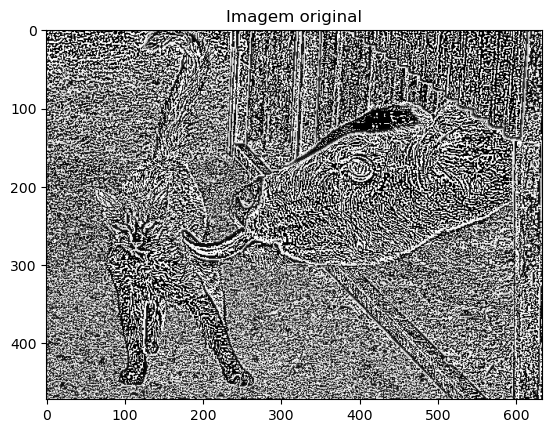

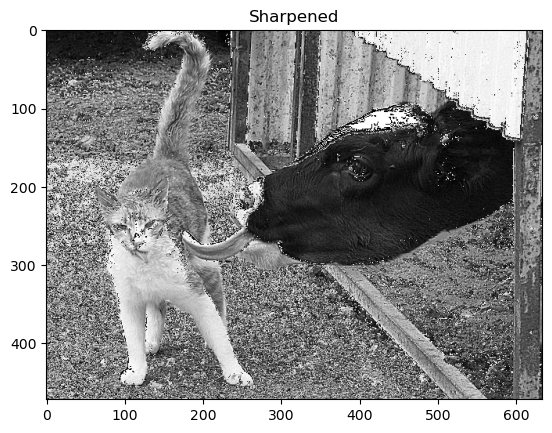

In [ ]:
################# COMPLETE O CÓDIGO AQUI  #################

# define o tamanho do kernel
dimMascara = 5
filtroMedia2 = cv2.blur( img2, (dimMascara,dimMascara) )

imgDetalhes = img2 - filtroMedia2

plt.imshow(imgDetalhes,'gray', vmax=255, vmin=0)
plt.title("Imagem original")
plt.show()

imgSharpened = img2+imgDetalhes

plt.imshow(imgSharpened,'gray', vmax=255, vmin=0)
plt.title("Sharpened")
plt.show()

##########################################################

---
**Exercício 1**. Faça o download do seguinte vídeo do Youtube disponível no seguinte link: https://www.youtube.com/watch?v=YVqgV_f3X00. 

Execute as seguintes operações nos frames do vídeo acima:

- Faça a equalização
- Aplique algum filtro de realce

Depois, salve um novo vídeo com as imagens processadas.

In [ ]:
!pip install pytube
from pytube import YouTube

# Insira o link do vídeo que deseja baixar
video_url = "https://www.youtube.com/watch?v=YVqgV_f3X00"

# Cria um objeto do tipo YouTube e obtém a stream do vídeo
yt = YouTube(video_url)
stream = yt.streams.get_highest_resolution()

pathFolder = "videos"
# verifica que a pasta existe
if not os.path.exists(pathFolder):
    # cria a pasta
    os.makedirs(pathFolder)
    
# Faz o download do vídeo
stream.download(output_path = pathFolder, filename="video1.mp4")

'/home/renato/Dropbox/Facens/aulas/2023-semestre01/disciplina_procImagens/aulas/notebooks/exPDI07_filtros/videos/video1.mp4'


Metadados do video: 
{'plugin': 'ffmpeg', 'nframes': inf, 'ffmpeg_version': '4.2.2-static https://johnvansickle.com/ffmpeg/ built with gcc 8 (Debian 8.3.0-6)', 'codec': 'h264', 'pix_fmt': 'yuv420p(tv, bt709)', 'audio_codec': 'aac', 'fps': 25.0, 'source_size': (1280, 720), 'size': (1280, 720), 'rotate': 0, 'duration': 10.05}


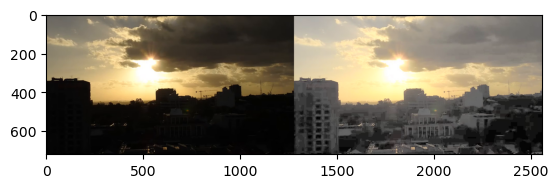

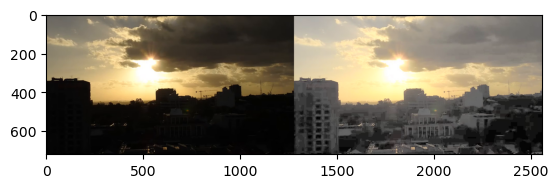

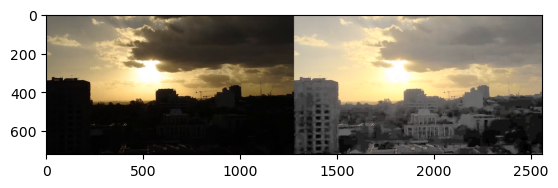

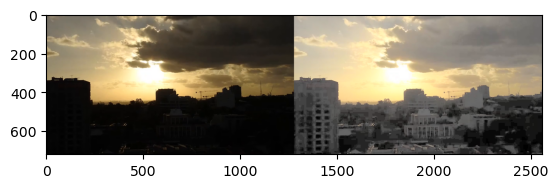

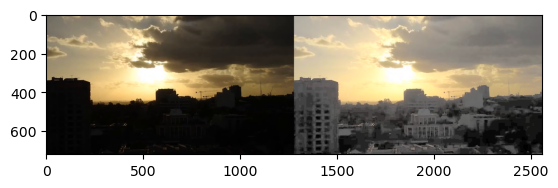

...

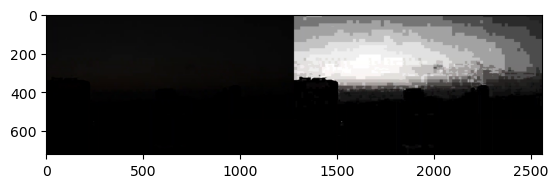

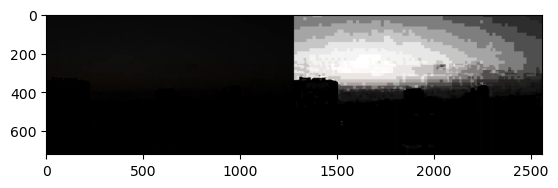

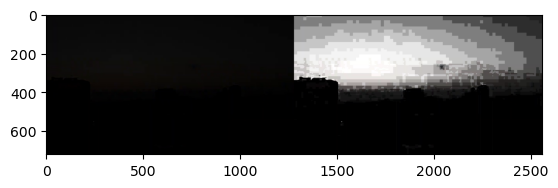

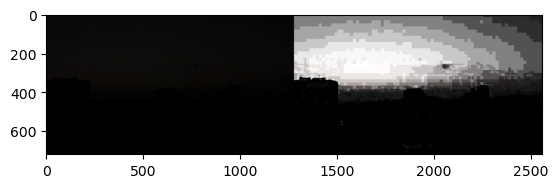

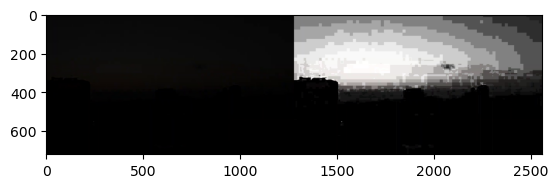

In [ ]:
!pip install imageio-ffmpeg

import imageio

video = imageio.get_reader('videos/video1.mp4', 'mp4')

metadata = video.get_meta_data()
print('\nMetadados do video: ')
print(metadata)

fps = video.get_meta_data()['fps']
videoSaida = imageio.get_writer('videos/videoProc.mp4', fps=fps)

# Read until video is completed
for frame in video.iter_data():
    
    ################# COMPLETE O CÓDIGO AQUI  #################

    
    # quando abrimos uma imagem com imread a as cores vem em BGR. Abaixo vamos mudar para RGB
    #frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB) 
    
    # converte RGB para YUV
    imagemColoridaYUV = cv2.cvtColor(frame, cv2.COLOR_RGB2YUV)
    
    # separa os canais 
    Y, U, V = cv2.split(imagemColoridaYUV)

    # faz a equalização da imagem
    YEqualizado = cv2.equalizeHist(Y)
    
    # junta o canal Y equalizado com os canais U e V para formar a nova imagem
    imgNovaYUV = cv2.merge([YEqualizado, U, V])
    
    # converte o formato YUV para RGB
    imgNovaRGB = cv2.cvtColor(imgNovaYUV, cv2.COLOR_YUV2RGB)
    
    # converte o formato YUV para RGB
    #imgNovaBGR = cv2.cvtColor(imgNovaRGB, cv2.COLOR_RGB2BGR)
    
    videoSaida.append_data( imgNovaRGB ); 
    
    # vertically concatenates images 
    # of same width 
    #imgh = cv2.hconcat([frame, imgNovaRGB])
    imgh = np.hstack((frame,imgNovaRGB))
    
    plt.imshow(imgh)
    plt.show()
    
    ##########################################################
    
# When everything done, release 
# the video capture and video 
# write objects
videoSaida.close()

Mostra o vídeo na tela

In [ ]:
from IPython.display import HTML
from base64 import b64encode
    
def showVideo(path):

    mp4 = open(path,'rb').read()
    data_url = "data:video/mp4;base64," + b64encode(mp4).decode()

    HTMLstring = """
    <video width=400 controls>
        <source src="%s" type="video/mp4">
    </video>""" % data_url

    display( HTML(HTMLstring) )

showVideo('videos/video1.mp4')
showVideo('videos/videoProc.mp4')